# UKRI Interview Project


Product Recommendation based on Customer Demographics

In [1]:
# Importing the primary libraries

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [2]:
# Importing the data

cust_data = pd.read_csv("Dataset/hh_demographic.csv")               # Customer/Household demographic
trans_data = pd.read_csv("Dataset/transaction_data.csv")            # Sales Transaction
product_data = pd.read_csv("Dataset/product.csv")                   # Product details
coup_data = pd.read_csv("Dataset/coupon.csv")                       # Coupon details
coup_red_data = pd.read_csv("Dataset/coupon_redempt.csv")           # Redeemde Coupons
camp_data = pd.read_csv("Dataset/campaign_table.csv")               # Marketing Campaigns
camp_desc_data = pd.read_csv("Dataset/campaign_desc.csv")           # Campaign details

In [3]:
cust_data.head(5)

,AGE_DESC,MARITAL_STATUS_CODE,INCOME_DESC,HOMEOWNER_DESC,HH_COMP_DESC,HOUSEHOLD_SIZE_DESC,KID_CATEGORY_DESC,household_key
0,65+,A,35-49K,Homeowner,2 Adults No Kids,2,None/Unknown,1
1,45-54,A,50-74K,Homeowner,2 Adults No Kids,2,None/Unknown,7
2,25-34,U,25-34K,Unknown,2 Adults Kids,3,1,8
3,25-34,U,75-99K,Homeowner,2 Adults Kids,4,2,13
4,45-54,B,50-74K,Homeowner,Single Female,1,None/Unknown,16


In [4]:
trans_data.head(5)

,household_key,BASKET_ID,DAY,PRODUCT_ID,QUANTITY,SALES_VALUE,STORE_ID,RETAIL_DISC,TRANS_TIME,WEEK_NO,COUPON_DISC,COUPON_MATCH_DISC
0,2375,26984851472,1,1004906,1,1.39,364,-0.60,1631,1,0.0,0.0
1,2375,26984851472,1,1033142,1,0.82,364,0.00,1631,1,0.0,0.0
2,2375,26984851472,1,1036325,1,0.99,364,-0.30,1631,1,0.0,0.0
3,2375,26984851472,1,1082185,1,1.21,364,0.00,1631,1,0.0,0.0
4,2375,26984851472,1,8160430,1,1.50,364,-0.39,1631,1,0.0,0.0


In [5]:
product_data.head(5)

,PRODUCT_ID,MANUFACTURER,DEPARTMENT,BRAND,COMMODITY_DESC,SUB_COMMODITY_DESC,CURR_SIZE_OF_PRODUCT
0,25671,2,GROCERY,National,FRZN ICE,ICE - CRUSHED/CUBED,22 LB
1,26081,2,MISC. TRANS.,National,NO COMMODITY DESCRIPTION,NO SUBCOMMODITY DESCRIPTION,
2,26093,69,PASTRY,Private,BREAD,BREAD:ITALIAN/FRENCH,
3,26190,69,GROCERY,Private,FRUIT - SHELF STABLE,APPLE SAUCE,50 OZ
4,26355,69,GROCERY,Private,COOKIES/CONES,SPECIALTY COOKIES,14 OZ


In [6]:
coup_data.head(5)

,COUPON_UPC,PRODUCT_ID,CAMPAIGN
0,10000089061,27160,4
1,10000089064,27754,9
2,10000089073,28897,12
3,51800009050,28919,28
4,52100000076,28929,25


In [7]:
coup_red_data.head(5)

,household_key,DAY,COUPON_UPC,CAMPAIGN
0,1,421,10000085364,8
1,1,421,51700010076,8
2,1,427,54200000033,8
3,1,597,10000085476,18
4,1,597,54200029176,18


In [8]:
camp_data.head(5)

,DESCRIPTION,household_key,CAMPAIGN
0,TypeA,17,26
1,TypeA,27,26
2,TypeA,212,26
3,TypeA,208,26
4,TypeA,192,26


In [9]:
camp_desc_data.head(5)

,DESCRIPTION,CAMPAIGN,START_DAY,END_DAY
0,TypeB,24,659,719
1,TypeC,15,547,708
2,TypeB,25,659,691
3,TypeC,20,615,685
4,TypeB,23,646,684


-----

# Exploratory Data Analysis

### Product Analysis

In [10]:
product_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92353 entries, 0 to 92352
Data columns (total 7 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   PRODUCT_ID            92353 non-null  int64 
 1   MANUFACTURER          92353 non-null  int64 
 2   DEPARTMENT            92353 non-null  object
 3   BRAND                 92353 non-null  object
 4   COMMODITY_DESC        92353 non-null  object
 5   SUB_COMMODITY_DESC    92353 non-null  object
 6   CURR_SIZE_OF_PRODUCT  92353 non-null  object
dtypes: int64(2), object(5)
memory usage: 4.9+ MB


In [11]:
# Total Department

total_departments = product_data['DEPARTMENT'].nunique()
print ("Total Department: ",total_departments)

Total Department:  44


In [12]:
# Total Categories

total_categories = product_data['COMMODITY_DESC'].nunique()
print ("Total Categories: ",total_categories)

Total Categories:  308


In [13]:
# Total Sub-Categories

total_sub_cat = product_data['SUB_COMMODITY_DESC'].nunique()
print ("Total Sub-Categories: ",total_sub_cat)

Total Sub-Categories:  2383


In [14]:
# Total Products

total_products = product_data['PRODUCT_ID'].nunique()
print ("Total Products: ",total_products)

Total Products:  92353


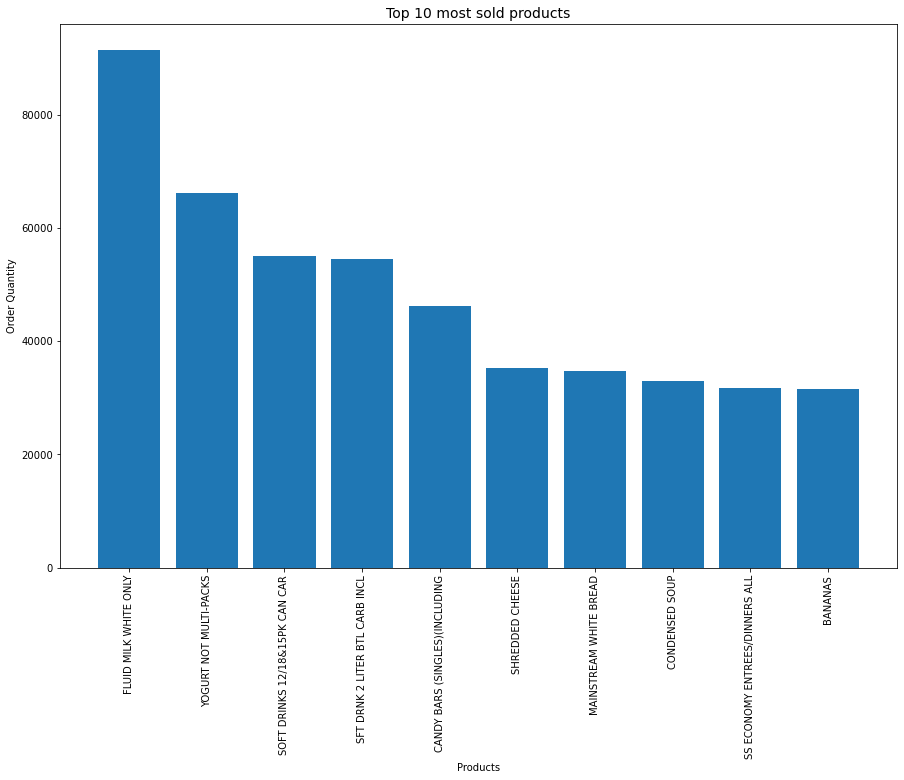

In [15]:
# top 10 Most sold products

# Merge product names with top_products based on Product_ID
top_products_with_names = pd.merge(trans_data[['PRODUCT_ID','QUANTITY']], product_data[['BRAND','DEPARTMENT','COMMODITY_DESC','SUB_COMMODITY_DESC','PRODUCT_ID']], on='PRODUCT_ID', how='left')

# Getting top 10 commmodities preferred by quantity ordered
product_counts = top_products_with_names.groupby('SUB_COMMODITY_DESC')['QUANTITY'].sum()
product_counts = product_counts.sort_values(ascending=False)

#Showing top 10 ordered by product counts, while omitting the first one.
top_products = product_counts.iloc[1:].nlargest(10)

# Bar chart with product names
plt.figure(figsize=(15,10))
plt.bar(x=top_products.index, height=top_products.values)
plt.xticks(rotation=90)
plt.xlabel('Products')
plt.ylabel('Order Quantity')
plt.title('Top 10 most sold products', fontsize=14)
plt.show()

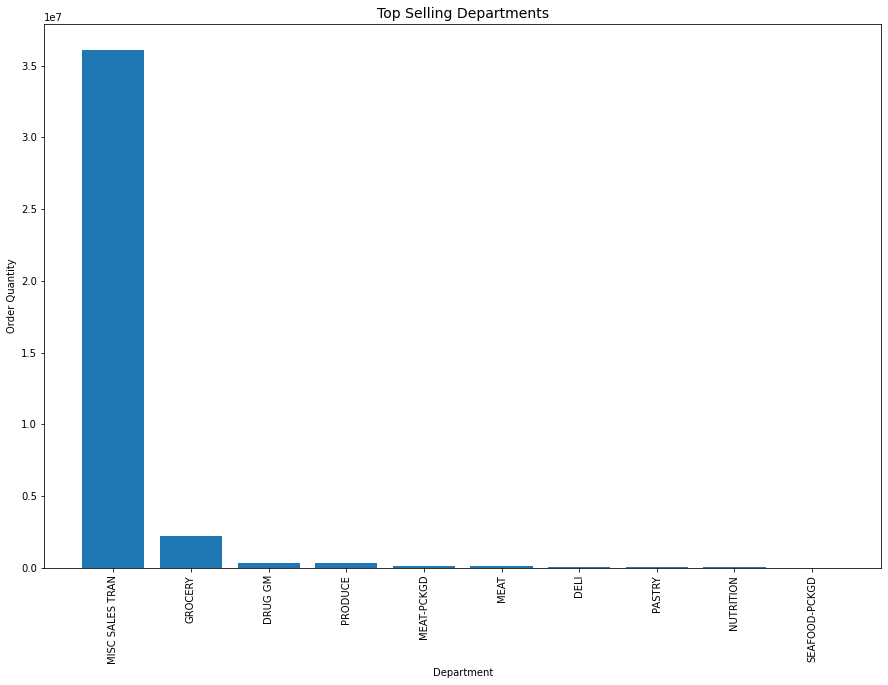

In [16]:
# Getting top 10 commmodities preferred by quantity ordered
department_counts = top_products_with_names.groupby('DEPARTMENT')['QUANTITY'].sum()
department_counts = department_counts.sort_values(ascending=False)

#Showing top 10 ordered by product counts, while omitting the first one.
top_department = department_counts.iloc[1:].nlargest(10)

# Bar chart with product names
plt.figure(figsize=(15,10))
plt.bar(x=top_department.index, height=top_department.values)
plt.xticks(rotation=90)
plt.xlabel('Department')
plt.ylabel('Order Quantity')
plt.title('Top Selling Departments', fontsize=14)
plt.show()

In [17]:
# Checking for duplicate rows (products)

product_data[product_data['SUB_COMMODITY_DESC'].duplicated(keep=False)]

,PRODUCT_ID,MANUFACTURER,DEPARTMENT,BRAND,COMMODITY_DESC,SUB_COMMODITY_DESC,CURR_SIZE_OF_PRODUCT
0,25671,2,GROCERY,National,FRZN ICE,ICE - CRUSHED/CUBED,22 LB
1,26081,2,MISC. TRANS.,National,NO COMMODITY DESCRIPTION,NO SUBCOMMODITY DESCRIPTION,
2,26093,69,PASTRY,Private,BREAD,BREAD:ITALIAN/FRENCH,
3,26190,69,GROCERY,Private,FRUIT - SHELF STABLE,APPLE SAUCE,50 OZ
4,26355,69,GROCERY,Private,COOKIES/CONES,SPECIALTY COOKIES,14 OZ
...,...,...,...,...,...,...,...
92348,18293142,6384,DRUG GM,National,BOOKSTORE,PAPERBACK BOOKS,
92349,18293439,6393,DRUG GM,National,BOOKSTORE,CHILDRENS LOW END,
92350,18293696,6406,DRUG GM,National,BOOKSTORE,PAPERBACK BEST SELLER,
92351,18294080,6442,DRUG GM,National,BOOKSTORE,PAPERBACK BOOKS,


In [18]:
# Sales Analysis

In [19]:
total_revenue = round(trans_data['SALES_VALUE'].sum(),2)
print ("Total Revenue Generated: ",total_revenue)

Total Revenue Generated:  8057463.08


In [20]:
total_quantity = trans_data['QUANTITY'].sum()
print ("Total Quantities Sold: ",total_quantity)

Total Quantities Sold:  260685622


In [21]:
# Discounts used from the coupons

total_discounts = round(trans_data['COUPON_DISC'].sum(),2)
print ("Total Discounts used at Checkout: ",total_discounts)

Total Discounts used at Checkout:  -42611.54


In [22]:
total_profit = total_revenue + total_discounts
print ("Overall Revenue: ",total_profit)

Overall Revenue:  8014851.54


#### Observation

Some Products have same sub_commodity_desc, commodity_desc, brand, and department, but were manufactured by different companies, hence different manufactures. 

----

### Campaign and Coupons


Campaign dataset contains identifying information for the marketing campaigns each household participated in.
The Campaign description explains the type of campaign and its duration.

Coupon table holds the data on the coupons asssociated with each campaign, and on what products they were used.
Coupon Redemption table tells what and how many coupons were used by customers, and when they were used.

In [23]:
camp_desc_data.head(5)

,DESCRIPTION,CAMPAIGN,START_DAY,END_DAY
0,TypeB,24,659,719
1,TypeC,15,547,708
2,TypeB,25,659,691
3,TypeC,20,615,685
4,TypeB,23,646,684


In [24]:
camp_desc_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   DESCRIPTION  30 non-null     object
 1   CAMPAIGN     30 non-null     int64 
 2   START_DAY    30 non-null     int64 
 3   END_DAY      30 non-null     int64 
dtypes: int64(3), object(1)
memory usage: 1.1+ KB


In [25]:
camp_data.head(5)

,DESCRIPTION,household_key,CAMPAIGN
0,TypeA,17,26
1,TypeA,27,26
2,TypeA,212,26
3,TypeA,208,26
4,TypeA,192,26


In [26]:
camp_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7208 entries, 0 to 7207
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   DESCRIPTION    7208 non-null   object
 1   household_key  7208 non-null   int64 
 2   CAMPAIGN       7208 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 169.1+ KB


In [27]:
coup_data.head(5)

,COUPON_UPC,PRODUCT_ID,CAMPAIGN
0,10000089061,27160,4
1,10000089064,27754,9
2,10000089073,28897,12
3,51800009050,28919,28
4,52100000076,28929,25


In [28]:
coup_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 124548 entries, 0 to 124547
Data columns (total 3 columns):
 #   Column      Non-Null Count   Dtype
---  ------      --------------   -----
 0   COUPON_UPC  124548 non-null  int64
 1   PRODUCT_ID  124548 non-null  int64
 2   CAMPAIGN    124548 non-null  int64
dtypes: int64(3)
memory usage: 2.9 MB


In [29]:
coup_red_data.head(5)

,household_key,DAY,COUPON_UPC,CAMPAIGN
0,1,421,10000085364,8
1,1,421,51700010076,8
2,1,427,54200000033,8
3,1,597,10000085476,18
4,1,597,54200029176,18


In [30]:
coup_red_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2318 entries, 0 to 2317
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   household_key  2318 non-null   int64
 1   DAY            2318 non-null   int64
 2   COUPON_UPC     2318 non-null   int64
 3   CAMPAIGN       2318 non-null   int64
dtypes: int64(4)
memory usage: 72.6 KB


In [31]:
# Total Campaigns

total_campaigns = camp_desc_data['CAMPAIGN'].nunique()
print ("Total Campaigns: ",total_campaigns)

Total Campaigns:  30


In [32]:
# Total Campaigns

total_coupons = coup_data['COUPON_UPC'].nunique()
print ("Total Coupons: ",total_coupons)

Total Coupons:  1135


In [33]:
redeemed_coupons = coup_red_data['COUPON_UPC'].nunique()
print ("Redeemed Coupons: ",redeemed_coupons)

Redeemed Coupons:  556


In [34]:
used_coupons = coup_red_data['COUPON_UPC'].count()
print ("Used Coupons: ",used_coupons)

Used Coupons:  2318


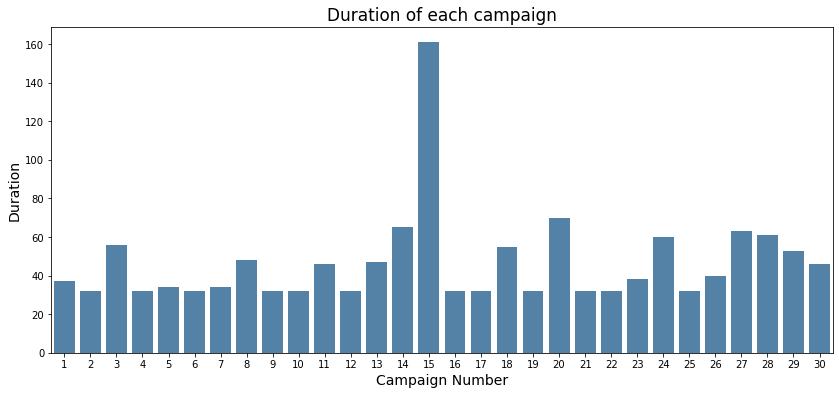

In [35]:
# Analysis of campaigns and their respective duration

camp_desc_data["DUR"] = camp_desc_data["END_DAY"] - camp_desc_data["START_DAY"]

fig = plt.figure(figsize=(14,6))
sns.barplot(x="CAMPAIGN",y="DUR",data=camp_desc_data, orient="v", 
            order=camp_desc_data.sort_values(by="CAMPAIGN").CAMPAIGN.values, color='steelblue')
plt.title('Duration of each campaign', fontsize=17)
plt.xlabel('Campaign Number', fontsize=14)
plt.ylabel('Duration', fontsize=14)
plt.show()

##### Observation:
Campaign No:15 lasts the longest with a staggering 160 days figure, where other campaigns are fairly close to each other ranging from 30 to 70 days.
Average campaign duration is 37 days (median)

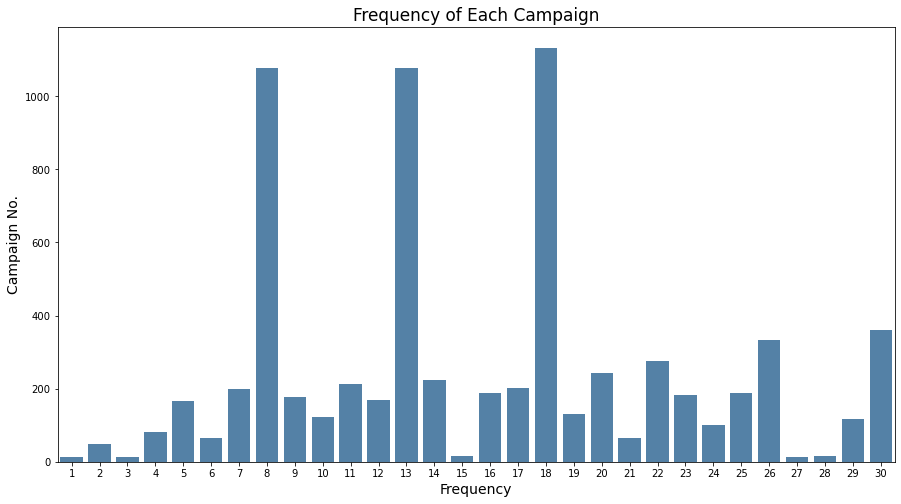

In [36]:
# Most Frequent Campaign

freq_campaigns = pd.DataFrame(list(zip(camp_data['CAMPAIGN'].value_counts().index, camp_data['CAMPAIGN'].value_counts())),columns=["Campaign","Frequency"])
fig = plt.figure(figsize=(15,8))
sns.barplot(x="Campaign",y="Frequency",data = freq_campaigns,orient="v", color='steelblue')
plt.title('Frequency of Each Campaign', fontsize=17)
plt.xlabel('Frequency', fontsize=14)
plt.ylabel('Campaign No.', fontsize=14)
plt.show()

##### Observation:

The most frequent campaign is Campaign 18, reaching more than 1000 customers, while the least campaigns are campaign 2 and 27.

In [37]:
# Checking for unique customers from the campaign table

len(camp_data["household_key"].unique())

1584

In [38]:
njn = camp_data["household_key"].value_counts()
njn

2317    17
2489    16
1527    15
718     15
2459    15
        ..
563      1
566      1
2021     1
2032     1
369      1
Name: household_key, Length: 1584, dtype: int64

In [39]:
njn.value_counts()

1     268
2     224
3     214
5     179
4     169
6     138
7     120
8      94
9      62
10     50
12     26
11     24
13      7
14      4
15      3
16      1
17      1
Name: household_key, dtype: int64

## Demographics

This explains the customer demographic table

In [40]:
cust_data.head(15)

,AGE_DESC,MARITAL_STATUS_CODE,INCOME_DESC,HOMEOWNER_DESC,HH_COMP_DESC,HOUSEHOLD_SIZE_DESC,KID_CATEGORY_DESC,household_key
0,65+,A,35-49K,Homeowner,2 Adults No Kids,2,None/Unknown,1
1,45-54,A,50-74K,Homeowner,2 Adults No Kids,2,None/Unknown,7
2,25-34,U,25-34K,Unknown,2 Adults Kids,3,1,8
3,25-34,U,75-99K,Homeowner,2 Adults Kids,4,2,13
4,45-54,B,50-74K,Homeowner,Single Female,1,None/Unknown,16
5,65+,B,Under 15K,Homeowner,2 Adults No Kids,2,None/Unknown,17
6,45-54,A,100-124K,Homeowner,2 Adults No Kids,2,None/Unknown,18
7,35-44,B,15-24K,Unknown,Single Female,1,None/Unknown,19
8,25-34,A,75-99K,Renter,2 Adults No Kids,2,None/Unknown,20
9,45-54,A,75-99K,Homeowner,2 Adults No Kids,2,None/Unknown,22


In [41]:
def bar_categorical(data, figsize=(20,30)):
    
    #function to plot the histogram of categorical variables in pie graph
    features = data.columns
    
    #plot pie charts of categorical variables
    fig_cat = plt.figure(figsize=figsize)
    count = 1
    
    #calculate dynamic numbers of subplot rows and columns
    cols = 2 #int(np.ceil(np.sqrt(len(features))))
    rows = int(np.ceil(len(features)/cols))
    
    for i in features:
        ax = fig_cat.add_subplot(rows,cols,count)
        data[i].value_counts().plot(kind="bar",ax=ax)
        plt.ylabel("")
        plt.xticks(rotation=0)
        plt.title(i,fontweight="bold", fontsize=8)
        count += 1

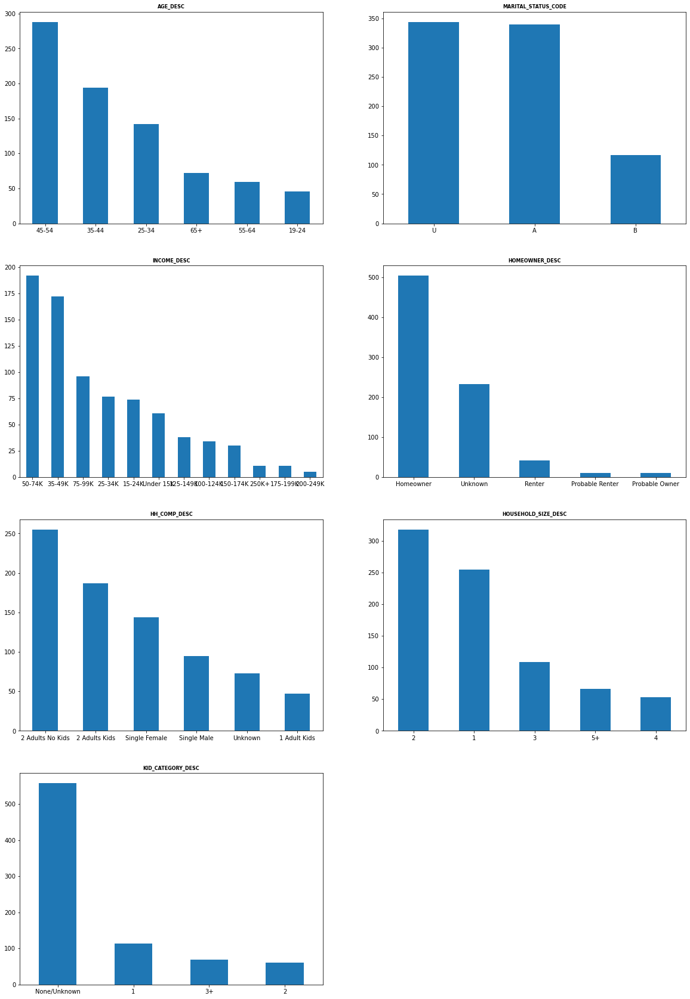

In [42]:
bar_categorical(cust_data.drop("household_key",axis=1))

----

# Feature Engineering

## 1. List of products in each basket.

In [43]:
trans_data.head(5)

,household_key,BASKET_ID,DAY,PRODUCT_ID,QUANTITY,SALES_VALUE,STORE_ID,RETAIL_DISC,TRANS_TIME,WEEK_NO,COUPON_DISC,COUPON_MATCH_DISC
0,2375,26984851472,1,1004906,1,1.39,364,-0.60,1631,1,0.0,0.0
1,2375,26984851472,1,1033142,1,0.82,364,0.00,1631,1,0.0,0.0
2,2375,26984851472,1,1036325,1,0.99,364,-0.30,1631,1,0.0,0.0
3,2375,26984851472,1,1082185,1,1.21,364,0.00,1631,1,0.0,0.0
4,2375,26984851472,1,8160430,1,1.50,364,-0.39,1631,1,0.0,0.0


In [44]:
# Counting the total number of baskets in the transaction table

total_baskets = len(trans_data["BASKET_ID"].unique())
total_baskets

276484

In [45]:
# Counting the total number of baskets in the transaction table

total_baskets = trans_data["WEEK_NO"].unique()
total_baskets

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  35,  34,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102], dtype=int64)

In [46]:
# what products are in each basket?

items_per_basket = trans_data.groupby("BASKET_ID")["PRODUCT_ID"].apply(list)
items_per_basket

BASKET_ID
26984851472        [1004906, 1033142, 1036325, 1082185, 8160430]
26984851516    [826249, 1043142, 1085983, 1102651, 6423775, 9...
26984896261             [842930, 897044, 920955, 937406, 981760]
26984905972          [833715, 866950, 1022843, 1048462, 1071333]
26984945254                            [824399, 923972, 1131351]
                                     ...                        
42302712006                 [882441, 1117219, 1135573, 14025651]
42302712189           [844054, 844759, 959737, 1135096, 9526344]
42302712298    [824005, 826144, 856345, 904148, 976199, 10526...
42305362497          [49659, 106589, 114397, 17295222, 17904923]
42305362535    [45277, 46427, 50293, 52641, 92130, 114102, 13...
Name: PRODUCT_ID, Length: 276484, dtype: object

In [47]:
# How many products are each in basket?

item_count_per_basket = items_per_basket.apply(len)
item_count_per_basket

BASKET_ID
26984851472     5
26984851516     6
26984896261     5
26984905972     5
26984945254     3
               ..
42302712006     4
42302712189     5
42302712298    11
42305362497     5
42305362535     9
Name: PRODUCT_ID, Length: 276484, dtype: int64

In [48]:
# Total sales in each basket

basket_sales = trans_data.groupby('BASKET_ID')['SALES_VALUE'].sum()
basket_sales

BASKET_ID
26984851472     5.91
26984851516    12.43
26984896261    11.37
26984905972     2.55
26984945254     3.53
               ...  
42302712006     9.78
42302712189    33.64
42302712298    40.70
42305362497     5.61
42305362535    32.32
Name: SALES_VALUE, Length: 276484, dtype: float64

In [49]:
# Calculate total sales for the entire dataset
total_sales = round(basket_sales.sum(),2)
total_sales

8057463.08

In [50]:
# mean basket sales

print(round(basket_sales.mean(), 2))

29.14


In [51]:
# Average Basket Size

basket_size = int(item_count_per_basket.mean())
basket_size

9

## 2. Basket Analysis by Customer

In [52]:
cust_data.head(5)

,AGE_DESC,MARITAL_STATUS_CODE,INCOME_DESC,HOMEOWNER_DESC,HH_COMP_DESC,HOUSEHOLD_SIZE_DESC,KID_CATEGORY_DESC,household_key
0,65+,A,35-49K,Homeowner,2 Adults No Kids,2,None/Unknown,1
1,45-54,A,50-74K,Homeowner,2 Adults No Kids,2,None/Unknown,7
2,25-34,U,25-34K,Unknown,2 Adults Kids,3,1,8
3,25-34,U,75-99K,Homeowner,2 Adults Kids,4,2,13
4,45-54,B,50-74K,Homeowner,Single Female,1,None/Unknown,16


In [53]:
# Checking for unique customers from the transaction table

total_households = len(trans_data["household_key"].unique())
total_households

2500

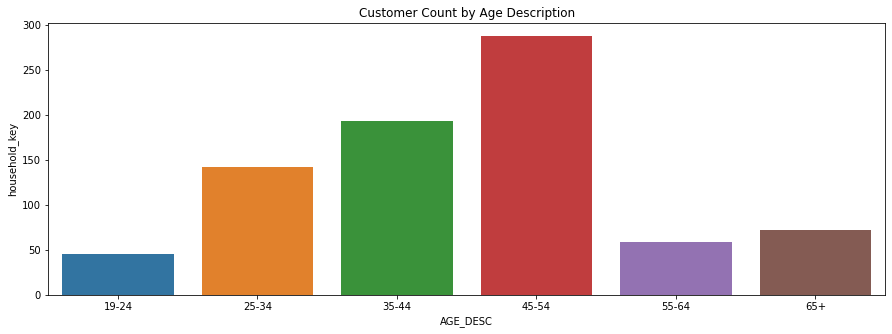

In [54]:
fig,ax = plt.subplots(figsize=(15,5))

cust_prof = cust_data.groupby("AGE_DESC")["household_key"].count().reset_index()
sns.barplot(y='household_key', data=cust_prof, x='AGE_DESC')
ax.set_title("Customer Count by Age Description");

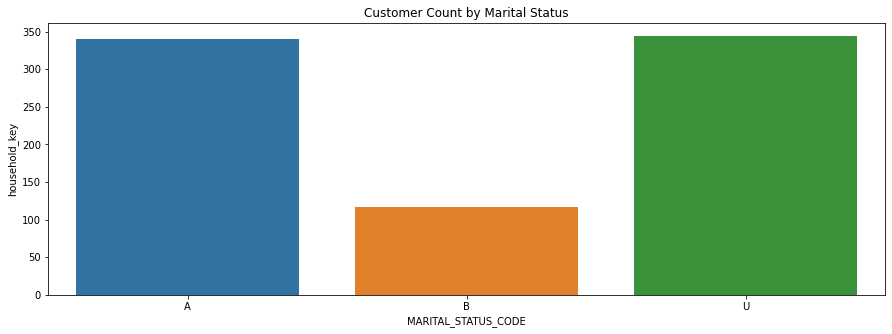

In [55]:
fig,ax = plt.subplots(figsize=(15,5))

cust_prof = cust_data.groupby("MARITAL_STATUS_CODE")["household_key"].count().reset_index()
sns.barplot(y='household_key', data=cust_prof, x='MARITAL_STATUS_CODE')
ax.set_title("Customer Count by Marital Status");

In [56]:
# customer attributed to a basket.

cust_per_basket = trans_data.groupby("household_key")["BASKET_ID"].unique().apply(list)
cust_per_basket

household_key
1       [27601281299, 27774192959, 28024266849, 281063...
2       [28210649301, 28331488785, 28391342107, 284058...
3       [28344561779, 28512211675, 28733108542, 287714...
4       [28243317097, 28788258186, 29019497887, 293922...
5       [27997276369, 28023500778, 28024107470, 281539...
                              ...                        
2496    [28391736778, 28601736009, 28771653897, 290354...
2497    [27913035576, 27936956147, 27950425454, 280239...
2498    [28243481507, 28243481960, 28282326654, 283180...
2499    [27816885334, 27816886345, 27997311883, 280929...
2500    [27924907417, 27924982026, 28057122795, 283182...
Name: BASKET_ID, Length: 2500, dtype: object

In [57]:
# All customer baskets and products in each basket

customer_basket_dict = {}

for customer_id, baskets in cust_per_basket.items():
    basket_list = []
    for basket_id in baskets:
        products_in_basket = trans_data.loc[trans_data['BASKET_ID'] == basket_id, 'PRODUCT_ID'].tolist()
        basket_list.append(products_in_basket)
    customer_basket_dict[customer_id] = basket_list

# Print the dictionary to see the representation
for customer_id, baskets in customer_basket_dict.items():
    print(f"Customer {customer_id}: {baskets}")

Customer 1: [[825123, 831447, 840361, 845307, 852014, 854982, 856942, 912676, 940947, 945805, 958046, 977545, 991024, 1006546, 1024128, 1043064, 1055201, 1055341, 1056509, 1056775, 1074612, 1082185, 1131115, 5566027, 5577022, 7167962, 7170493, 7410037, 7431134, 8069064], [852662, 856942, 997025, 1030547, 1049998, 1055831, 1082185, 6773032, 7167962, 8090541, 9297615, 9527290], [841266, 865178, 953561, 991024, 995242, 995904, 1033142, 1075074, 1088462, 1135096, 9527066, 9527290], [827656, 831447, 845896, 852662, 856942, 857540, 876042, 878285, 905448, 933303, 933913, 945805, 991580, 995242, 1008626, 1024128, 1074612, 1078449, 5577022, 5978656, 6514011, 7167962, 9655212], [852662, 856942, 887375, 909472, 922417, 931136, 932949, 977658, 995242, 1109465, 5565840, 5577022, 7167962, 7441419, 8181377, 9527290, 10149640], [856942, 860548, 925987, 934369, 953561, 985055, 995242, 1056509, 7167962, 9297615], [849066, 866227, 960732, 965541, 995242, 1073143, 6704052, 7410037, 9655212], [830775, 846

## 3. Favourite Products

In [58]:
# Top 20 products shopped frequently by each customer

from collections import Counter

# Dictionary to store the top 20 most bought products for each customer
top_products_per_customer = {}

# Iterate over each customer's shopping history
for customer_id, baskets in customer_basket_dict.items():
    # Flatten the list of products across all baskets
    all_products = [product for basket in baskets for product in basket]
    
    # Count the occurrences of each product
    product_counts = Counter(all_products)
    
    # Extract the top 20 most frequent products
    top_product_ids = [product_id for product_id, _ in product_counts.most_common(20)]
    
    # Store the top products for the current customer
    top_products_per_customer[customer_id] = top_product_ids

# Print the top 10 most bought products for each customer
for customer_id, top_products in top_products_per_customer.items():
    print(f"{customer_id}: {top_products}")

1: [856942, 1082185, 995242, 940947, 1049998, 9527290, 1074612, 5577022, 9297615, 991580, 9655212, 938004, 840361, 958046, 1006546, 1043064, 931136, 877391, 1075074, 1082269]
2: [1133018, 8090521, 1106523, 5569230, 916122, 1075368, 951590, 1040807, 940947, 826784, 1098066, 901062, 1076580, 1053690, 885023, 1103898, 904236, 9707240, 974306, 989101]
3: [1092026, 1053690, 951590, 998206, 1106523, 910032, 938700, 921345, 1082185, 1092937, 9527494, 885697, 937791, 835476, 1101173, 13842214, 904360, 9337581, 864615, 932761]
4: [883932, 6391541, 891423, 962229, 910109, 943030, 936470, 1052294, 1013868, 1121367, 902172, 1075368, 912669, 951821, 1137010, 883404, 6773204, 822178, 868075, 887003]
5: [6904776, 6773079, 1126899, 5995628, 925054, 992765, 1050851, 1071939, 5995589, 5995609, 935393, 1073042, 1123022, 5568378, 1096036, 874972, 962199, 938983, 5980822, 1012352]
6: [1082185, 1119051, 840361, 1037863, 863447, 1024306, 5569230, 845208, 13003092, 849843, 965267, 1127831, 994928, 962568, 109

In [59]:
# Creating a new column in the cust_data for each customer's fav products

# Convert the dictionary to a DataFrame
cust_fave_products = pd.DataFrame(top_products_per_customer.items(), columns=['household_key', 'fave_products'])

# Each household favourite products with their household keys
cust_fave_products


,household_key,fave_products
0,1,"[856942, 1082185, 995242, 940947, 1049998, 952..."
1,2,"[1133018, 8090521, 1106523, 5569230, 916122, 1..."
2,3,"[1092026, 1053690, 951590, 998206, 1106523, 91..."
3,4,"[883932, 6391541, 891423, 962229, 910109, 9430..."
4,5,"[6904776, 6773079, 1126899, 5995628, 925054, 9..."
...,...,...
2495,2496,"[981760, 916122, 883404, 995876, 5569230, 1056..."
2496,2497,"[860776, 995785, 1066685, 965719, 896938, 8705..."
2497,2498,"[1070820, 1082185, 1126899, 1053690, 961554, 9..."
2498,2499,"[1070820, 826249, 5568378, 5570048, 944317, 99..."


----

# Customer Segmentation

In [60]:
# Converting the categorical to numerical

# clonning the Cust_data
clust = cust_data.copy()


from sklearn.preprocessing import LabelEncoder


# Initialize a dictionary to store encoders
label_encoding_info = {}

# Iterate through each column in the DataFrame
for col in clust.columns:

    # Skip the 'fave_products' column:
    if col == 'household_key':
        continue

    # Check if the column data type is object (categorical)
    if clust[col].dtype == 'object':
        # Check if the column contains lists
        if clust[col].apply(type).eq(list).any():

            # Flatten lists and convert to strings
            clust[col] = clust[col].apply(lambda x: ','.join(map(str, x)))

        # Initialize LabelEncoder for the column
        label_encoder = LabelEncoder()
        
        # Fit LabelEncoder on the column and transform the data
        clust[col] = label_encoder.fit_transform(clust[col])

        # Store the unique labels and their corresponding encoded values in the dictionary
        unique_labels = list(label_encoder.classes_)
        unique_encoded_values = list(set(clust[col]))


        label_encoding_info[col] = {}
        # Add the unique labels and their encoded values to the dictionary under the column name
        for label, encoded_value in zip(unique_labels, unique_encoded_values):
            label_encoding_info[col][label] = encoded_value
        
        # Store the fitted encoder in the dictionary
        # label_encoding_info[col] = {'encoded_values': clust[col].tolist(), 'labels': list(label_encoder.classes_)}

        
print(label_encoding_info) 

{'AGE_DESC': {'19-24': 0, '25-34': 1, '35-44': 2, '45-54': 3, '55-64': 4, '65+': 5}, 'MARITAL_STATUS_CODE': {'A': 0, 'B': 1, 'U': 2}, 'INCOME_DESC': {'100-124K': 0, '125-149K': 1, '15-24K': 2, '150-174K': 3, '175-199K': 4, '200-249K': 5, '25-34K': 6, '250K+': 7, '35-49K': 8, '50-74K': 9, '75-99K': 10, 'Under 15K': 11}, 'HOMEOWNER_DESC': {'Homeowner': 0, 'Probable Owner': 1, 'Probable Renter': 2, 'Renter': 3, 'Unknown': 4}, 'HH_COMP_DESC': {'1 Adult Kids': 0, '2 Adults Kids': 1, '2 Adults No Kids': 2, 'Single Female': 3, 'Single Male': 4, 'Unknown': 5}, 'HOUSEHOLD_SIZE_DESC': {'1': 0, '2': 1, '3': 2, '4': 3, '5+': 4}, 'KID_CATEGORY_DESC': {'1': 0, '2': 1, '3+': 2, 'None/Unknown': 3}}


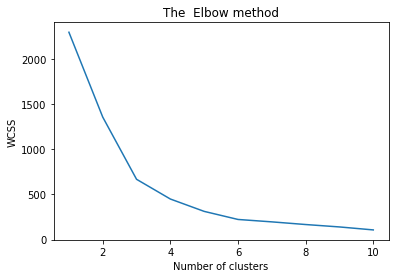

In [61]:
# Performing the Elbow method to obtain the optimal number of clusters

X = clust.iloc[:,[0,6]].values

from sklearn.cluster import KMeans
wcss = []

for i in range(1,11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1,11),wcss)
plt.title('The  Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [62]:
# From the elbow method, the best number of clusters to use is 6.

kmeans = KMeans(n_clusters = 6, init = 'k-means++', random_state = 42)
y_kmeans = kmeans.fit_predict(X)

# Add cluster labels to the customer demographics DataFrame
clust['Cluster'] = y_kmeans
print(y_kmeans)

[1 3 0 0 3 1 3 2 4 3 2 3 2 2 3 1 2 3 4 2 3 1 5 3 0 3 2 1 2 1 3 4 1 3 0 5 2
 0 4 4 0 4 1 3 3 5 3 3 3 3 1 3 2 3 0 4 3 3 0 3 1 0 0 4 3 3 3 0 3 3 5 1 2 1
 2 3 1 3 1 2 4 2 2 3 3 1 0 0 5 3 4 0 3 3 2 2 3 4 3 4 0 1 0 5 4 0 4 5 3 3 3
 3 0 4 2 3 1 5 3 3 4 2 3 1 1 1 0 3 1 0 3 4 2 4 2 3 1 0 2 0 4 4 1 2 1 3 3 0
 3 4 4 0 4 2 3 0 3 4 1 4 1 1 1 1 3 3 3 4 2 1 2 3 3 1 0 3 3 1 3 3 3 4 4 0 3
 2 3 4 4 0 0 2 1 4 5 2 0 2 2 0 5 0 2 0 0 3 3 4 3 0 3 2 5 3 0 5 1 0 1 3 5 2
 2 2 3 1 2 0 1 1 3 0 2 3 3 4 0 1 5 1 3 3 2 3 3 5 3 3 5 0 5 2 5 2 4 2 2 3 2
 4 3 5 3 1 4 4 0 3 4 4 1 4 2 5 4 0 0 3 5 2 3 4 0 4 1 5 4 3 2 2 5 3 1 0 0 0
 2 3 2 2 0 0 3 1 2 2 1 5 4 3 3 3 3 2 5 4 3 3 4 4 1 4 4 3 2 0 0 0 4 0 3 5 5
 4 5 1 1 3 3 2 4 2 5 3 3 3 2 0 2 1 4 4 4 4 1 2 2 1 2 4 2 5 4 1 3 0 3 3 0 5
 0 1 0 5 5 5 1 2 3 2 4 3 3 3 3 1 2 4 5 0 4 4 4 4 3 2 3 3 4 2 5 0 3 0 3 1 3
 0 3 2 5 5 5 3 1 3 4 3 4 0 3 1 0 1 1 2 0 5 0 3 1 1 4 3 5 5 2 1 1 0 1 0 4 1
 1 4 3 0 1 3 2 3 1 3 1 5 0 2 2 3 0 1 3 0 0 3 2 2 3 5 5 1 2 4 0 1 3 2 4 3 4
 4 4 2 4 1 1 1 1 3 3 5 3 

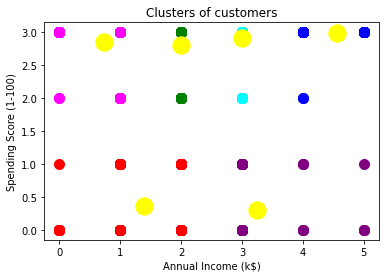

In [63]:
plt.scatter(X[y_kmeans == 0 ,0],X[y_kmeans == 0 ,1], s=100, c='red', label='Cluster 1')
plt.scatter(X[y_kmeans == 1 ,0],X[y_kmeans == 1 ,1], s=100, c='blue', label='Cluster 2')
plt.scatter(X[y_kmeans == 2 ,0],X[y_kmeans == 2 ,1], s=100, c='green', label='Cluster 3')
plt.scatter(X[y_kmeans == 3 ,0],X[y_kmeans == 3 ,1], s=100, c='cyan', label='Cluster 4')
plt.scatter(X[y_kmeans == 4 ,0],X[y_kmeans == 4 ,1], s=100, c='magenta', label='Cluster 5')
plt.scatter(X[y_kmeans == 5 ,0],X[y_kmeans == 5 ,1], s=100, c='purple', label='Cluster 6')
plt.scatter(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1], s=300, c='yellow', label='Centroids')
plt.title('Clusters of customers')
plt.xlabel('Annual Income (k$)')
plt.ylabel('Spending Score (1-100)')
plt.show()

In [64]:
cust_fave_products

,household_key,fave_products
0,1,"[856942, 1082185, 995242, 940947, 1049998, 952..."
1,2,"[1133018, 8090521, 1106523, 5569230, 916122, 1..."
2,3,"[1092026, 1053690, 951590, 998206, 1106523, 91..."
3,4,"[883932, 6391541, 891423, 962229, 910109, 9430..."
4,5,"[6904776, 6773079, 1126899, 5995628, 925054, 9..."
...,...,...
2495,2496,"[981760, 916122, 883404, 995876, 5569230, 1056..."
2496,2497,"[860776, 995785, 1066685, 965719, 896938, 8705..."
2497,2498,"[1070820, 1082185, 1126899, 1053690, 961554, 9..."
2498,2499,"[1070820, 826249, 5568378, 5570048, 944317, 99..."


In [65]:
# Merging the cluster labels to the favourite products table.

cust_fave_products = pd.merge(cust_fave_products, clust[['household_key','Cluster']], on='household_key', how='left')
cust_fave_products = cust_fave_products.dropna()
cust_fave_products['Cluster'] = cust_fave_products['Cluster'].astype(int)
cust_fave_products

,household_key,fave_products,Cluster
0,1,"[856942, 1082185, 995242, 940947, 1049998, 952...",1
6,7,"[1082185, 1122358, 1022003, 6944571, 1106523, ...",3
7,8,"[1082185, 8181377, 5569230, 969932, 1005186, 5...",0
12,13,"[6534178, 1029743, 995242, 1082185, 5978656, 1...",0
15,16,"[2495324, 2445642, 2496543, 12138402, 2476511,...",3
...,...,...,...
2493,2494,"[1082185, 840361, 862349, 1071939, 849843, 653...",2
2495,2496,"[981760, 916122, 883404, 995876, 5569230, 1056...",5
2496,2497,"[860776, 995785, 1066685, 965719, 896938, 8705...",3
2497,2498,"[1070820, 1082185, 1126899, 1053690, 961554, 9...",4


In [66]:
# Dropping the household_key column on the clust table as it is no longer needed.

clust = clust.drop(columns='household_key', axis=1)
clust


,AGE_DESC,MARITAL_STATUS_CODE,INCOME_DESC,HOMEOWNER_DESC,HH_COMP_DESC,HOUSEHOLD_SIZE_DESC,KID_CATEGORY_DESC,Cluster
0,5,0,8,0,2,1,3,1
1,3,0,9,0,2,1,3,3
2,1,2,6,4,1,2,0,0
3,1,2,10,0,1,3,1,0
4,3,1,9,0,3,0,3,3
...,...,...,...,...,...,...,...,...
796,2,2,9,0,2,1,3,2
797,3,0,10,0,5,2,0,5
798,3,2,8,4,4,0,3,3
799,1,2,9,0,2,1,3,4


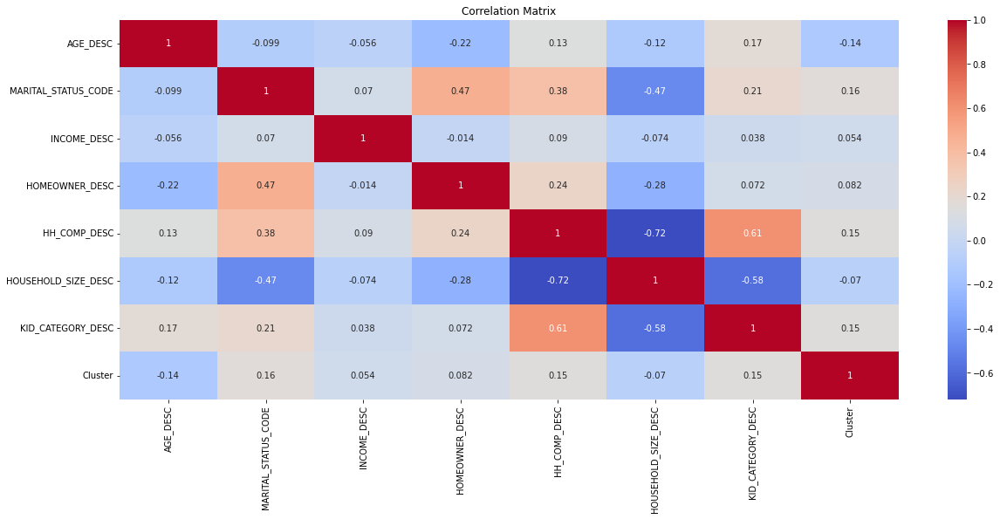

In [67]:
corr_matrix = clust.corr()

# Plot the correlation matrix using a heatmap
plt.figure(figsize=(20, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

-----

# Building the Recommendation Model

In [68]:
'''
    After clustering the customers and also assigning the cluster labels,
    The dataset is trained by asssigning the demogrpahics to the X train and test, and the cluster label to the y train and test
'''



# Splitting the data

X = clust.drop(['Cluster'], axis=1)
y = clust['Cluster']

X

,AGE_DESC,MARITAL_STATUS_CODE,INCOME_DESC,HOMEOWNER_DESC,HH_COMP_DESC,HOUSEHOLD_SIZE_DESC,KID_CATEGORY_DESC
0,5,0,8,0,2,1,3
1,3,0,9,0,2,1,3
2,1,2,6,4,1,2,0
3,1,2,10,0,1,3,1
4,3,1,9,0,3,0,3
...,...,...,...,...,...,...,...
796,2,2,9,0,2,1,3
797,3,0,10,0,5,2,0
798,3,2,8,4,4,0,3
799,1,2,9,0,2,1,3


In [69]:
y

0      1
1      3
2      0
3      0
4      3
      ..
796    2
797    5
798    3
799    4
800    0
Name: Cluster, Length: 801, dtype: int32

In [70]:
# Classifications to be considered

# KNN
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()


# Decision Tree
from sklearn.tree import DecisionTreeClassifier
dct = DecisionTreeClassifier()


# Kernel SVM
from sklearn.svm import SVC
ksvm = SVC()


# XGboost
from xgboost import XGBClassifier
xgb = XGBClassifier()

In [71]:
#classifiers to be compared 
classifiers = [knn, dct, ksvm, xgb]

In [72]:
# Using Hyperparameter tuning to eradicate the possibility of overfitting in the training modelby using parameters that will give the best model performance
from sklearn.model_selection import GridSearchCV


#Checking the best classifier using cross validation
from sklearn.model_selection import cross_val_score

# Define the hyperparameters grid for each classifier
param_grid_knn = {'n_neighbors': [3, 5, 7]}
param_grid_dct = {'criterion': ['gini', 'entropy'], 'max_depth': [None, 10, 20]}
param_grid_ksvm = {'C': [0.1, 1, 10], 'gamma': [0.1, 0.01, 0.001], 'kernel': ['linear', 'rbf']}
param_grid_xgb = {'max_depth': [3, 5, 7], 'learning_rate': [0.1, 0.01, 0.001]}

# Define the hyperparameter grids for all classifiers
param_grids = [param_grid_knn, param_grid_dct, param_grid_ksvm, param_grid_xgb]

# Initialize a list to store the best classifiers
best_classifiers = []

print ("Hyperparamter Tuning Result:\n\n")

# Perform hyperparameter tuning for each classifier
for classifier, param_grid in zip(classifiers, param_grids):
    grid_search = GridSearchCV(classifier, param_grid, cv=4, scoring='accuracy')
    grid_search.fit(X, y)
    best_classifier = grid_search.best_estimator_
    best_classifiers.append(best_classifier)
    print(f"Best parameters for {type(classifier).__name__}: {grid_search.best_params_}")
    print(f"Best cross-validation accuracy: {grid_search.best_score_}\n")

# Select the best classifier based on cross-validation accuracy
best_classifier = max(best_classifiers, key=lambda x: cross_val_score(x, X, y, cv=4).mean())
print(f"The best classifier is: {type(best_classifier).__name__}")

Hyperparamter Tuning Result:


Best parameters for KNeighborsClassifier: {'n_neighbors': 3}
Best cross-validation accuracy: 0.8364738805970149

Best parameters for DecisionTreeClassifier: {'criterion': 'gini', 'max_depth': None}
Best cross-validation accuracy: 1.0

Best parameters for SVC: {'C': 0.1, 'gamma': 0.1, 'kernel': 'linear'}
Best cross-validation accuracy: 1.0

Best parameters for XGBClassifier: {'learning_rate': 0.1, 'max_depth': 3}
Best cross-validation accuracy: 1.0

The best classifier is: DecisionTreeClassifier


In [73]:
# Splitting the Model

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
display(X_train.shape, X_test.shape)

(640, 7)

(161, 7)

In [74]:
# Feature Scaling the X data

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [75]:
#import necessary libraries to train the model with the classifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import f1_score
from sklearn.metrics import classification_report

In [76]:
# Training the K-NN model on the Training set

knn = KNeighborsClassifier(n_neighbors = 3, metric = 'minkowski', p = 2)
knn.fit(X_train, y_train)


# Predicting the test results
knn_pred = knn.predict(X_test)

In [77]:
# Decision Tree Classification

dct = DecisionTreeClassifier(criterion = 'gini', random_state = 0)
dct.fit(X_train, y_train)

# Predicting the test results
dct_pred = dct.predict(X_test)

In [88]:
# Kernel SVM

ksvm = SVC(kernel = 'linear', random_state = 0)
ksvm.fit(X_train, y_train)


# Predicting the test results
ksvm_pred = ksvm.predict(X_test)

In [79]:
# XGBoost Classifier

# Train the model on the training data
xgb.fit(X_train, y_train)

# Make predictions on the test data
xgb_pred = xgb.predict(X_test)

----

# Model Evaluation

In [80]:
#check the accuracy of the prediction using different metrics
knn_report = classification_report(y_test, knn_pred)
print('Classification Report KNN:')
print(knn_report)

Classification Report KNN:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       0.93      0.78      0.85        18
           2       0.83      0.83      0.83        30
           3       0.83      0.93      0.88        42
           4       0.96      0.86      0.91        28
           5       0.93      1.00      0.97        14

    accuracy                           0.90       161
   macro avg       0.91      0.90      0.90       161
weighted avg       0.90      0.90      0.90       161



In [81]:
#check the accuracy of the prediction using different metrics
dct_report = classification_report(y_test, dct_pred)
print('Classification Report Decision Tree:')
print(dct_report)

Classification Report Decision Tree:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00        18
           2       1.00      1.00      1.00        30
           3       1.00      1.00      1.00        42
           4       1.00      1.00      1.00        28
           5       1.00      1.00      1.00        14

    accuracy                           1.00       161
   macro avg       1.00      1.00      1.00       161
weighted avg       1.00      1.00      1.00       161



In [82]:
#check the accuracy of the prediction using different metrics
ksvm_report = classification_report(y_test, ksvm_pred)
print('Classification Report Kernel SVM:')
print(ksvm_report)

Classification Report Kernel SVM:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00        18
           2       0.97      1.00      0.98        30
           3       1.00      1.00      1.00        42
           4       1.00      0.96      0.98        28
           5       1.00      1.00      1.00        14

    accuracy                           0.99       161
   macro avg       0.99      0.99      0.99       161
weighted avg       0.99      0.99      0.99       161



In [83]:
#check the accuracy of the prediction using different metrics
xgb_report = classification_report(y_test, xgb_pred)

print('Classification Report for XGBoost')
print(xgb_report)

Classification Report for XGBoost
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00        18
           2       1.00      1.00      1.00        30
           3       1.00      1.00      1.00        42
           4       1.00      1.00      1.00        28
           5       1.00      1.00      1.00        14

    accuracy                           1.00       161
   macro avg       1.00      1.00      1.00       161
weighted avg       1.00      1.00      1.00       161



In [84]:
cm = confusion_matrix(y_test, xgb_pred)
print("Confusion Matrix:\n\n")
print(cm)
accuracy_score(y_test, xgb_pred)

Confusion Matrix:


[[29  0  0  0  0  0]
 [ 0 18  0  0  0  0]
 [ 0  0 30  0  0  0]
 [ 0  0  0 42  0  0]
 [ 0  0  0  0 28  0]
 [ 0  0  0  0  0 14]]


1.0

In [85]:
# Testing the models with a known demographic

print("KNN Predicted: ", knn.predict(sc.transform([[3,2,8,4,4,0,3]])))
print("Decison Tree Predicted: ", dct.predict(sc.transform([[3,2,8,4,4,0,3]])))
print("Kernel SVM Predicted: ", ksvm.predict(sc.transform([[3,2,8,4,4,0,3]])))
print("XGBoost Classifier Predicted: ", xgb.predict(sc.transform([[3,2,8,4,4,0,3]])))

KNN Predicted:  [3]
Decison Tree Predicted:  [3]
Kernel SVM Predicted:  [3]
XGBoost Classifier Predicted:  [3]


In [86]:
# Testing the models with an unknown demographic

print("KNN Predicted: ", knn.predict(sc.transform([[4,0,7,2,0,0,0]])))
print("Decison Tree Predicted: ", dct.predict(sc.transform([[4,0,7,2,0,0,0]])))
print("Kernel SVM Predicted: ", ksvm.predict(sc.transform([[4,0,7,2,0,0,0]])))
print("XGBoost Classifier Predicted: ", xgb.predict(sc.transform([[4,0,7,2,0,0,0]])))

KNN Predicted:  [5]
Decison Tree Predicted:  [5]
Kernel SVM Predicted:  [5]
XGBoost Classifier Predicted:  [5]


In [87]:
#Checking the best classifier using cross validation
from sklearn.model_selection import cross_val_score

#classifiers to be compared 
classifier_scores = {}

for classifier in classifiers:
    accuracy_scores = cross_val_score(classifier, X_train, y_train, cv=4)  # 4-fold cross-validation
    mean_accuracy = accuracy_scores.mean()
    classifier_scores[type(classifier).__name__] = mean_accuracy
    
    print(f"Classifier: {type(classifier).__name__}, Mean Accuracy: {mean_accuracy}")
    best_classifier = max(classifier_scores, key=classifier_scores.get)

print(f"The best classifier is: {best_classifier}")


Classifier: KNeighborsClassifier, Mean Accuracy: 0.8656250000000001
Classifier: DecisionTreeClassifier, Mean Accuracy: 0.996875
Classifier: SVC, Mean Accuracy: 0.984375
Classifier: XGBClassifier, Mean Accuracy: 1.0
The best classifier is: XGBClassifier


----

# Deployment and Testing

In [89]:
# The best and recommended classifier to use is the XGBoost Classifier, hence the 'xgb' model is saved.

# Import the joblib library
import joblib

# Save the trained model to a file
joblib.dump(xgb, 'xgb_model.pkl')

# Later, when you want to make predictions:
# Load the saved model from the file
xgb_loaded = joblib.load('xgb_model.pkl')

In [90]:
import random


# Step 1: Search the fave_products data for households under the predicted clusters
def search_by_cluster(pred_cluster):
    similar_customers = cust_fave_products[
        (cust_fave_products['Cluster'] == pred_cluster)
    ]

    return similar_customers



# Step 2: Select Frequent Products
def select_frequent_products(similar_customers):
    frequent_products = set()
    
    for cluster in similar_customers['Cluster']:
        products_series = cust_fave_products.loc[cust_fave_products['Cluster'] == cluster, 'fave_products'].iloc[0]

        # Sort the products based on their frequency and select the top 10
        top_products = sorted(products_series, key=products_series.count, reverse=True)[:10]
        frequent_products.update(top_products)

    # Randomly select 10 products from the combined frequent products list
    recommended_products = random.sample(frequent_products, min(10, len(frequent_products)))
    
    return recommended_products



# Step 3: Fetch Product Names
def fetch_product_names(frequent_product_ids, product_table):
    product_names = product_table.loc[product_table['PRODUCT_ID'].isin(frequent_product_ids), 'SUB_COMMODITY_DESC'].tolist()
    return product_names





# Step 4: Display Recommended Products
def display_recommended_products(recommended_product_names):
    print("Recommended Products:")
    for product_name in recommended_product_names:
        print("- " + product_name)


In [99]:
# Example Usage:
customer_demographics = {
    'AGE_DESC': '25-34', 
    'MARITAL_STATUS_CODE': 'A', 
    'INCOME_DESC': 'Under 15K', 
    'HOMEOWNER_DESC': 'Renter', 
    'HH_COMP_DESC': '2 Adults No Kids', 
    'HOUSEHOLD_SIZE_DESC': '1', 
    'KID_CATEGORY_DESC': 'None/Unknown'
}


encoded_demographics = []

# Encode the customer_demographics using the label encoding mappings
for key, value in customer_demographics.items():
    encoded_value = label_encoding_info[key][value]
    encoded_demographics.append(encoded_value)


# Recommending a product
pred_c = xgb.predict(sc.transform([encoded_demographics]))

for i in range(0, len(pred_c)):
    pred_cluster = pred_c[i]


# pred_cluster
similar_customers = search_by_cluster(pred_cluster)
frequent_products = select_frequent_products(similar_customers)
recommended_product_names = fetch_product_names(frequent_products, product_data)
display_recommended_products(recommended_product_names)

Recommended Products:
- ECONOMY - MEAT
- CAKES: ANGEL FDS/CKE ROLLS
- FRZN WHIPPED TOPPING
- SOFT DRINKS 20PK&24PK CAN CARB
- FLUID MILK WHITE ONLY
- CIGARETTES
- FROZEN FRUIT
- FLUID MILK WHITE ONLY
- GASOLINE-REG UNLEADED
- SOFT DRINKS 12/18&15PK CAN CAR
